In [1]:
from pathlib import Path
import lungmask
import nibabel as nib
import numpy as np

import lungseg
from lungseg.dcm_reader import SeriesLoader
from lungseg.visualization import plot_seria_to_10

import matplotlib.pyplot as plt

# Intro
This notebook demonstrates abilities of lungseg - module to predict segmentation mask on Chest CT images.
Example provided here taken from [NSCLC dataset](https://wiki.cancerimagingarchive.net/pages/viewpage.action?pageId=68551327#68551327bcab02c187174a288dbcbf95d26179e8). If you want to reproduce results consider to download data from official source.

## Paths settings
Set paths to dicom data, masks and checkpoints (lung segmentation and body orientation). Set patient_id if it's necessary

In [2]:
folder_dcms = Path('./NSCLC/CT/NSCLC-Radiomics/')
patient_id = '357'
path_dcm = list(folder_dcms.joinpath(f'LUNG1-{patient_id}').glob('*/*/'))[0]
path_mask = f'./NSCLC/Thoracic Segmentations/LUNG1-{patient_id}/lungMask_edit.nii'

## Load data + GT mask
Load dicom data via SeriesLoader from folder and read GT mask. Turn it to fit.

In [3]:
dicom = SeriesLoader(folder_to_dicoms=path_dcm)
slices = dicom.slices

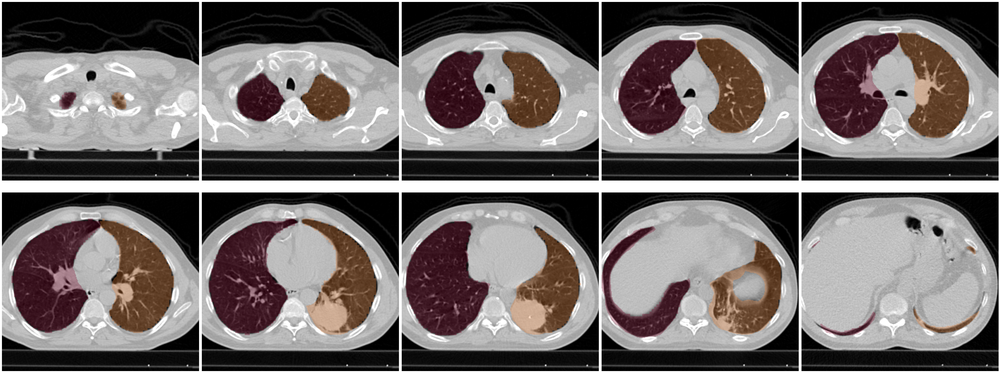

In [4]:
mask_gt = np.array(nib.load(path_mask).get_fdata(), dtype=np.int8)
mask_gt = np.moveaxis(mask_gt, 1, 0)
mask_gt = mask_gt[::-1, :, ::-1]

fig = plot_seria_to_10(slices[100:400, 100:430, 25:115], masks_vol=mask_gt[100:400, 100:430, 25:115], msk_extrems=(0, 2))
plt.show()

## Rotate slices
There could be a case, that the patient is lying on his stomach on image. Modify the data to augment it.

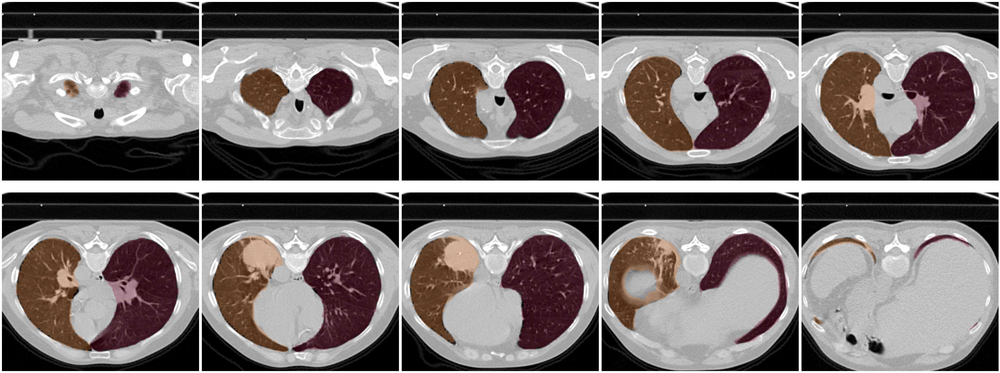

In [5]:
slices_rot = dicom.slices[::-1, ::-1, :]
mask_gt_rot = mask_gt[::-1, ::-1, :]

fig = plot_seria_to_10(slices_rot[100:400, 100:430, 25:115], mask_gt_rot[100:400, 100:430, 25:115], msk_extrems=(0, 2))
plt.show()

##  Usage LungSeg
It's easy to predict lungs segmentation mask via lungseg - just run LungSegmentor! You could specify your own paths to model's checkpoints if necessary.

In [6]:
segmentor = lungseg.LungSegmentor()
# segmentor = lungseg.LungSegmentor(local_path_lungseg=path_lung_segmentation,
#                                   local_path_bodyorient=path_bodyorientation)
mask_lungseg = segmentor.predict(slices) # inference for normal patient orientation
mask_lungseg_rot = segmentor.predict(slices_rot) # inference for rotated patient orientation

  0%|          | 0.00/57.5M [00:00<?, ?B/s]

  0%|          | 0.00/132M [00:00<?, ?B/s]

/home/roman/anaconda3/envs/lungseg/lib/python3.7/site-packages/torch/nn/functional.py:3063: UserWarning: Default upsampling behavior when mode=bilinear is changed to align_corners=False since 0.4.0. Please specify align_corners=True if the old behavior is desired. See the documentation of nn.Upsample for details.
  "See the documentation of nn.Upsample for details.".format(mode))


# LungSeg vs LungMask
This section shows a comparison for results from [lungseg](https://github.com/Botkin-AI/lungseg) and alternative open source lib - [lungmask](https://github.com/JoHof/lungmask) on original and rotated image. 
As you can see below, lungseg correctly predict which lung is left or right while lungmask mixed up. Also note huge tumor which is corresponds to lungs on lungseg prediction. 


Default output labels for left and right lungs are different for lungseg and lungmask: 

lungseg: 0 - background, 1 - left lung, 2 - right lung

lungmask: 0 - background, 1 - right lung, 2 - left lung

So to compare outputs we should remap lungmask labels (function remap_lung_labels)

In [7]:
def change_output_labels_to_match(mask):
    mask_c = np.zeros_like(mask)
    mask_c[mask == 1] = 2
    mask_c[mask == 2] = 1
    mask_c = np.moveaxis(mask_c, 0, 2)
    return mask_c

In [8]:
from lungmask import mask
import SimpleITK as sitk

sitk_array = sitk.GetImageFromArray(np.moveaxis(slices, 2, 0))  # lungmask expect slices axis as 0 dim and as sitk Image
mask_lungmask = mask.apply(sitk_array)
mask_lungmask = change_output_labels_to_match(mask_lungmask)

sitk_array_rot = sitk.GetImageFromArray(np.moveaxis(slices_rot, 2, 0))  # lungmask expect slices axis as 0 dim and as sitk Image
mask_lungmask_rot = mask.apply(sitk_array_rot)
mask_lungmask_rot = change_output_labels_to_match(mask_lungmask_rot)

100%|██████████| 43/43 [00:00<00:00, 87.12it/s] 


# Normal patient orientation
## Ground truth segmentation

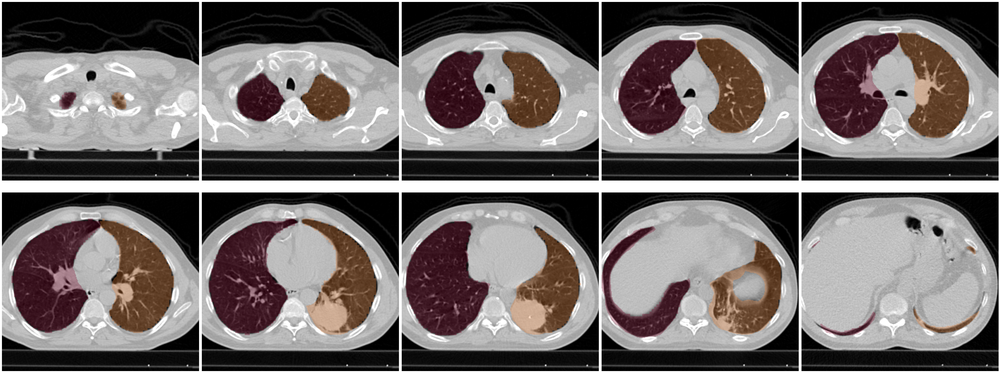

In [9]:
fig = plot_seria_to_10(slices[100:400, 100:430, 25:115], mask_gt[100:400, 100:430, 25:115], msk_extrems=(0, 2))
plt.show()

## Predicted segmentation by lungseg

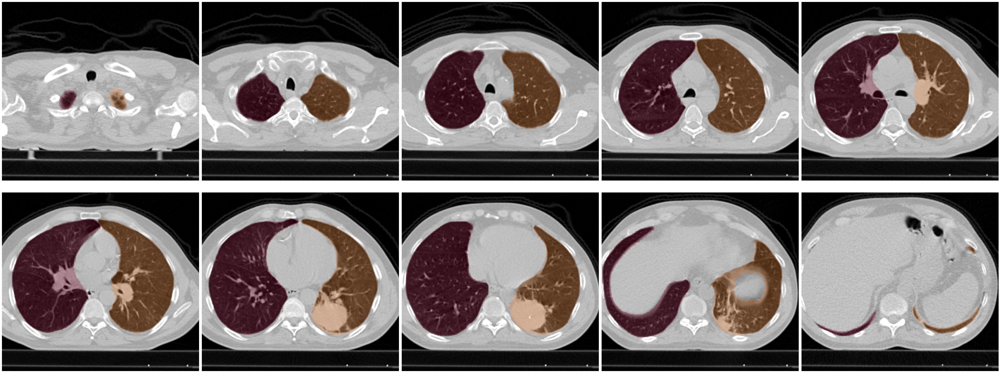

In [10]:
fig = plot_seria_to_10(slices[100:400, 100:430, 25:115], mask_lungseg[100:400, 100:430, 25:115], msk_extrems=(0, 2))
plt.show()

## Predicted segmentation by lungmask

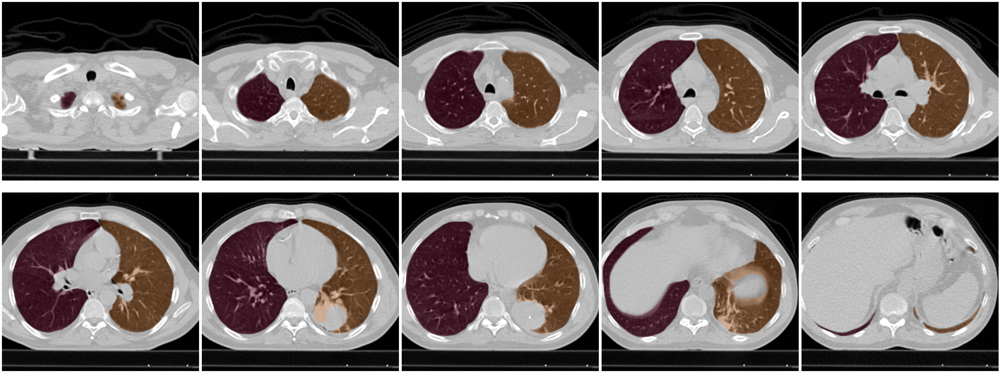

In [11]:
fig = plot_seria_to_10(slices[100:400, 100:430, 25:115], mask_lungmask[100:400, 100:430, 25:115], msk_extrems=(0, 2))
plt.show()

# Rotated patient orientation
## Ground truth segmentation

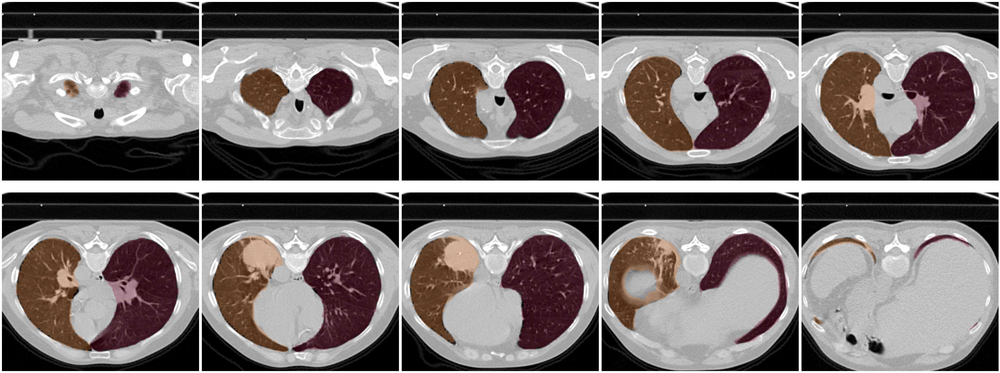

In [12]:
fig = plot_seria_to_10(slices_rot[100:400, 100:430, 25:115], mask_gt_rot[100:400, 100:430, 25:115], msk_extrems=(0, 2))
plt.show()

## Predicted segmentation by lungseg

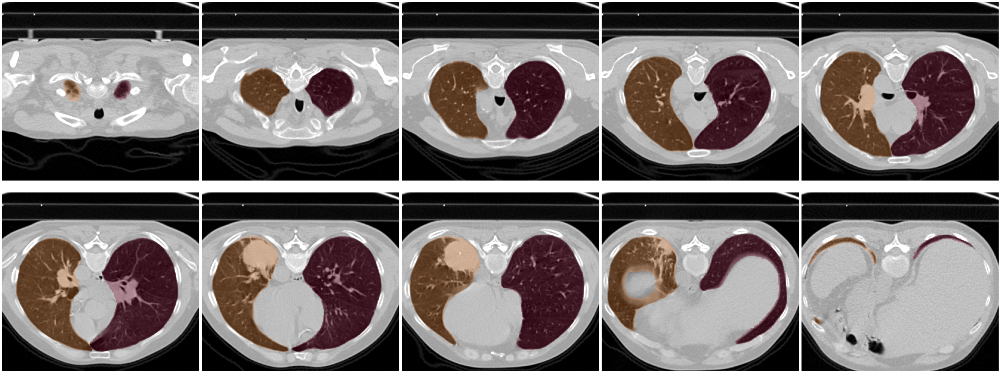

In [13]:
fig = plot_seria_to_10(slices_rot[100:400, 100:430, 25:115], mask_lungseg_rot[100:400, 100:430, 25:115], msk_extrems=(0, 2))
plt.show()

## Predicted segmentation by lungmask

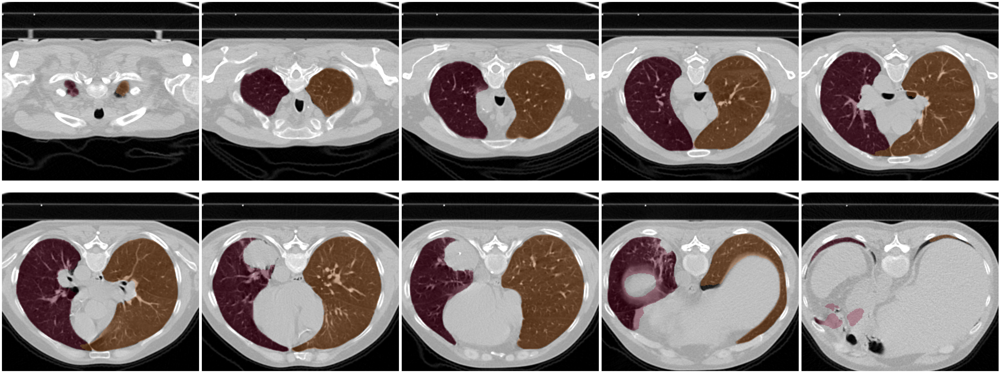

In [14]:
fig = plot_seria_to_10(slices_rot[100:400, 100:430, 25:115], mask_lungmask_rot[100:400, 100:430, 25:115], msk_extrems=(0, 2))
plt.show()